# Fitting ellipses to James Webb Space Telescope's cartwheel galaxy images

In [1]:
import Pkg

# activate parent environment
Pkg.activate(normpath(joinpath(@__DIR__, ".")))
Pkg.resolve()
Pkg.instantiate()
Pkg.status()

using Clustering
using Wavelets
using WaveletsExt

using Images
using ImageEdgeDetection
using ImageEdgeDetection: Percentile
using ImageFeatures
using Wavelets, LinearOperatorCollection
using RegularizedLeastSquares

using DSP
using Plots

using LinearAlgebra
using SCS
using JuMP

  Activating project at `c:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification`
  No Changes to `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Project.toml`
  No Changes to `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Manifest.toml`


Status `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Project.toml`
  [1e616198] COSMO v0.8.9
  [aaaa29a8] Clustering v0.15.7
⌅ [5ae59095] Colors v0.12.11
  [717857b8] DSP v0.7.10
  [5789e2e9] FileIO v1.16.6
  [87dc4568] HiGHS v1.12.1
  [2b14c160] ImageEdgeDetection v0.1.8
  [92ff4b2b] ImageFeatures v0.5.3
  [4e3cecfd] ImageShow v0.3.8
  [86fae568] ImageView v0.12.6
  [916415d5] Images v0.26.1
  [4076af6c] JuMP v1.23.5
  [a4a2c56f] LinearOperatorCollection v2.0.7
  [429524aa] Optim v1.10.0
⌃ [91a5bcdd] Plots v1.40.7
  [92933f4c] ProgressMeter v1.10.2
  [1e9c538a] RegularizedLeastSquares v0.16.6
  [c946c3f1] SCS v2.0.2
  [29a6e085] Wavelets v0.10.0
  [8f464e1e] WaveletsExt v0.2.2
Info Packages marked with ⌃ and ⌅ have new versions available. Those with ⌃ may be upgradable, but those with ⌅ are restricted by compatibility constraints from upgrading. To see why use `status --outdated`


## Read the image

Image size: (1024, 1024) - image dyadic size: (true, true)


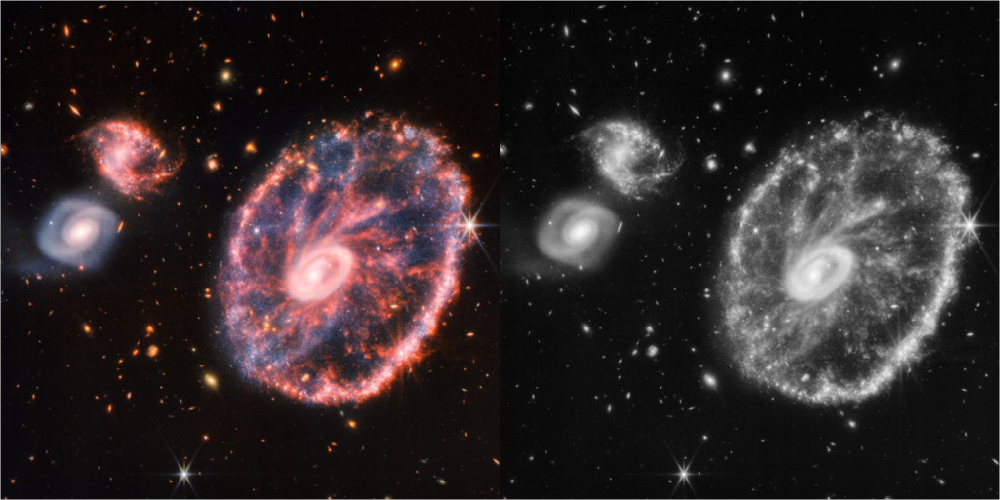

In [2]:
# read image (cartwheel galaxy)
directory_path = "."
image_path = joinpath(directory_path, "cartwheel_galaxies_JWST.png")
img = load(image_path)
println("Image size: ", size(img), " - image dyadic size: ", isdyadic.(size(img)))

# convert image to gray scale
img_gray = Gray.(img)
mosaicview(img, img_gray; nrow=1)

## Helper functions

In [3]:
function mexican_hat_filter(n)
    filter = zeros(n, n)
    for i in 1:n
        for j in 1:n
            x = i - n / 2
            y = j - n / 2
            filter[i, j] = (1 - (x^2 + y^2) / (n^2)) * exp(-(x^2 + y^2) / (2 * n^2))
        end
    end
    return filter
end

function plot_dwt(x)
    plt = heatmap(x, color=:grays, aspect_ratio=1, cbar=false,
        xlims=(0, size(x, 2)),
        ylims=(0, size(x, 1)),
        size=(700, 700),
        dpi=300
    )
end

function flip(x)
    return x[end:-1:1, :]
end

function normalize(x)
    x = (x .- minimum(x)) ./ (maximum(x) - minimum(x))
    return x
end

normalize (generic function with 1 method)

## Sparsification

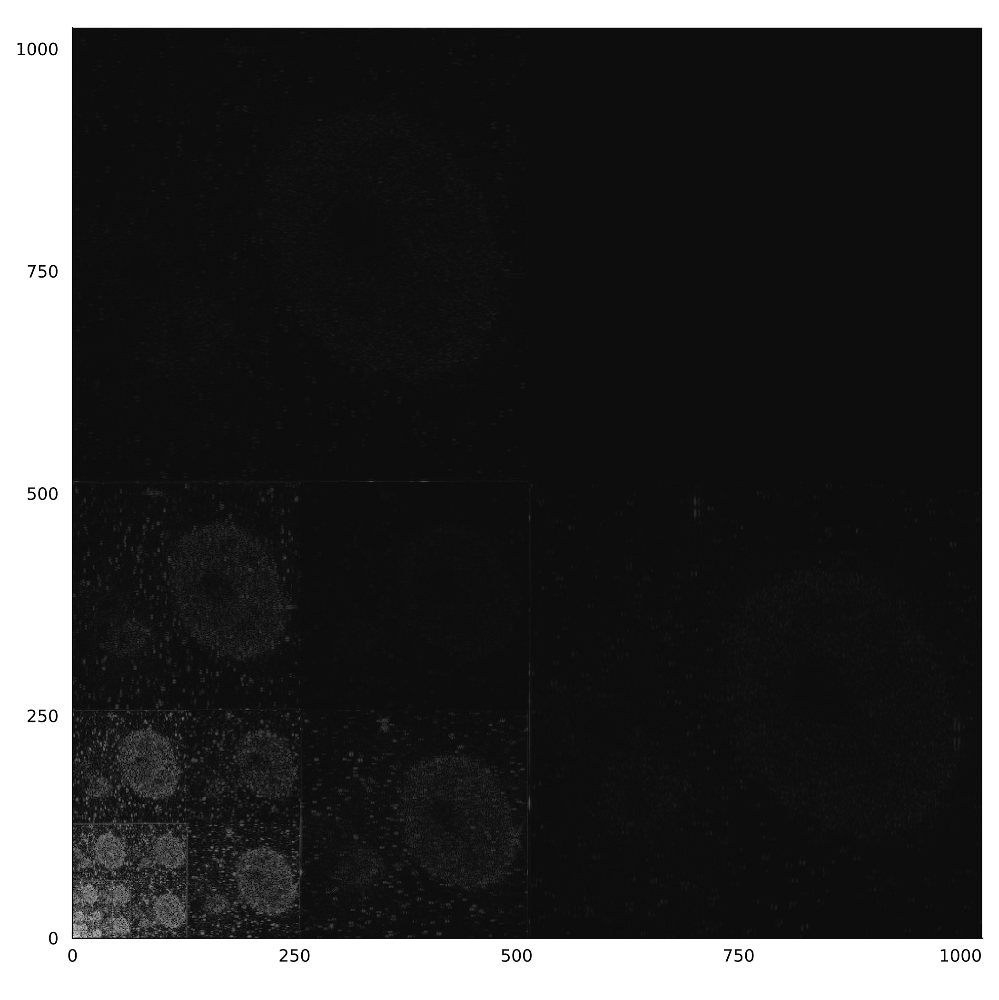

In [4]:
# turn image into a matrix of floats
x = convert(Array{Float64}, img_gray)

# apply the mexican hat filter
K = 9
S = Int(floor((K / 2)))
mh_filter = mexican_hat_filter(K)

x_filt = DSP.conv(Matrix{Float64}(x), mh_filter)
N, M = size(x_filt)
x_filt = x_filt[S+1:N-S, S+1:M-S]
x_filt = normalize(x_filt)

# obtain wavelet operator matrix A
wt = wavelet(WT.coif4)
wop = WaveletOp(Float64, shape=size(x_filt), wt=wt)

wavelet_x = reshape(wop * vec(x_filt), size(x_filt))
wavelet_x = log.(abs.(wavelet_x) .+ 0.01)

plot_dwt(wavelet_x)

In [5]:
# define regularizer with L1 norm
core = RegularizedLeastSquares.L1Regularization(0.2)
reg = TransformedRegularization(core, wop);

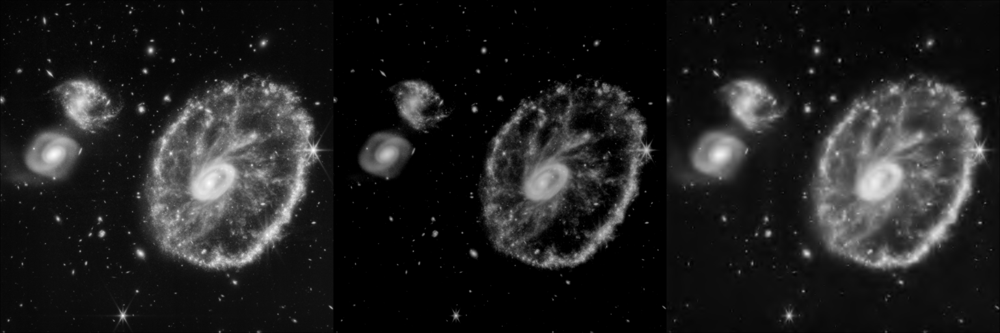

In [6]:
# apply proximal operator
img_prox_img = prox!(core, copy(vec(x)));
img_prox_wavelet = prox!(reg, copy(vec(x)));

# reshape
img_prox_img = reshape(img_prox_img, size(x))
img_prox_wavelet = reshape(img_prox_wavelet, size(x))

mosaicview(x, Gray.(img_prox_img), Gray.(img_prox_wavelet); nrow=1)

## Solving the inverse problem

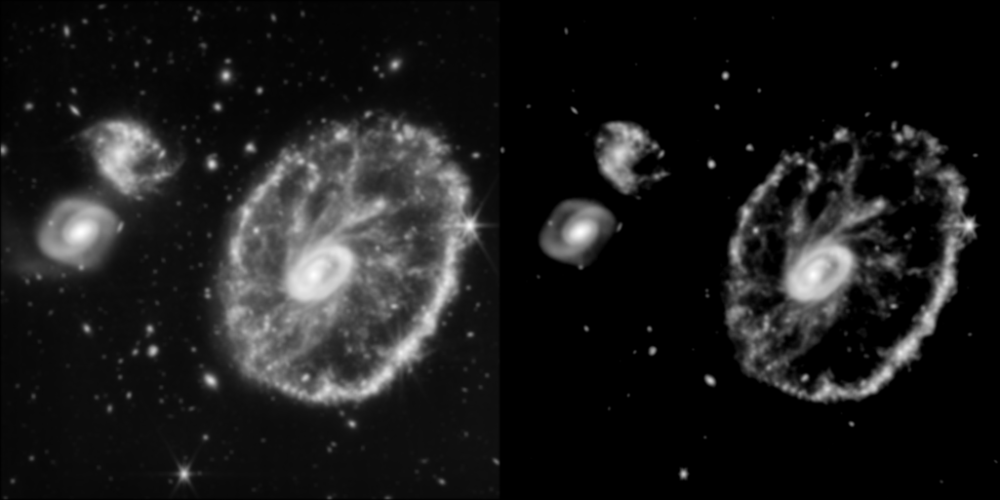

In [7]:
# total variation regularization
# reg = TVRegularization(0.001; shape=size(x));
reg = L1Regularization(0.3);

# wavelet operator matrix A
A = WaveletOp(Float64, shape=size(x_filt), wt=wavelet(WT.coif4));

# build optimization solver
solver = createLinearSolver(OptISTA, A; reg=reg, iterations=40);

# sampled image in wavelet domain
b = A * vec(x_filt);

x_approx = solve!(solver, b)
x_approx = reshape(x_approx, size(x_filt));

x̂_final = normalize(x_approx)

mosaicview(x_filt, Gray.(x̂_final); nrow=1)

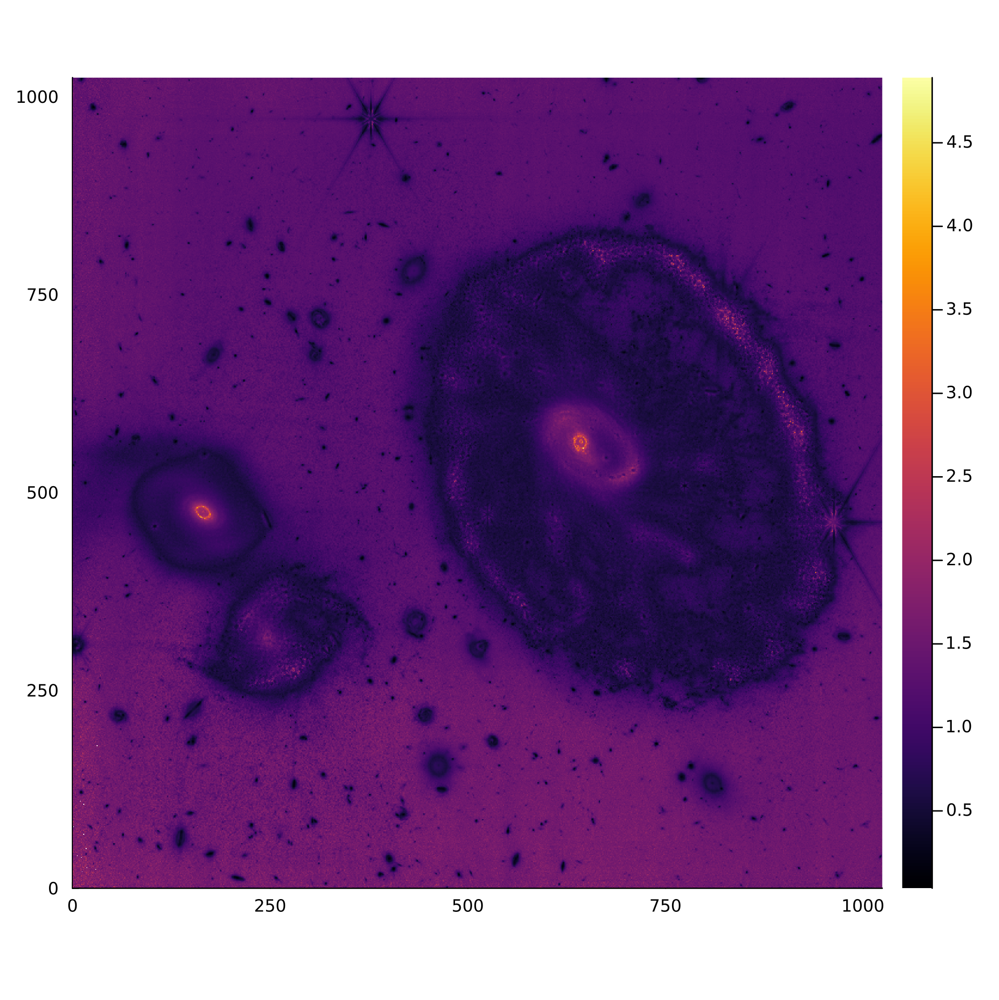

In [8]:
x_diff = -log10.(abs.(x .- x̂_final))
heatmap(x_diff, aspect_ratio=1,
    cbar=true,
    xlims=(0, size(x, 2)),
    ylims=(0, size(x, 1)),
    size=(700, 700),
    dpi=300
)

## Binarization

In [ ]:
function canny_edge_detector(f_smooth::Matrix{Float64}, d1::Float64=0.1, d2::Float64=0.1)
    # Dimensions of the image
    rows, cols = size(f_smooth)

    # Preallocate arrays for gradient and Laplacian
    gradient_magnitude = zeros(Float64, rows, cols)
    laplacian_magnitude = zeros(Float64, rows, cols)
    edge_matrix = zeros(Bool, rows, cols)  # Binary matrix for edges

    # Sobel filters
    sobel_x = [-1 0 1; -2 0 2; -1 0 1]
    sobel_y = [-1 -2 -1; 0 0 0; 1 2 1]
    sobel_xx = [-1 2 -1; 2 -4 2; -1 2 -1]
    sobel_yy = [-1 2 -1; 2 -4 2; -1 2 -1]

    # Convolve the image with the Sobel filters
    gradient_x = conv(f_smooth, sobel_x)
    gradient_y = conv(f_smooth, sobel_y)

    # Compute the gradient magnitude
    gradient_magnitude = sqrt.(gradient_x .^ 2 + gradient_y .^ 2)

    # second derivative
    gradient_xx = conv(f_smooth, sobel_xx)
    gradient_yy = conv(f_smooth, sobel_yy)
    laplacian_magnitude = sqrt.(gradient_xx .^ 2 + gradient_yy .^ 2)

    # thresholding with d1, d2
    for i in 1:rows
        for j in 1:cols
            if gradient_magnitude[i, j] > d1 && laplacian_magnitude[i, j] < d2
                edge_matrix[i, j] = true
            end
        end
    end

    return edge_matrix, gradient_magnitude, laplacian_magnitude
end

canny_edge_detector (generic function with 3 methods)

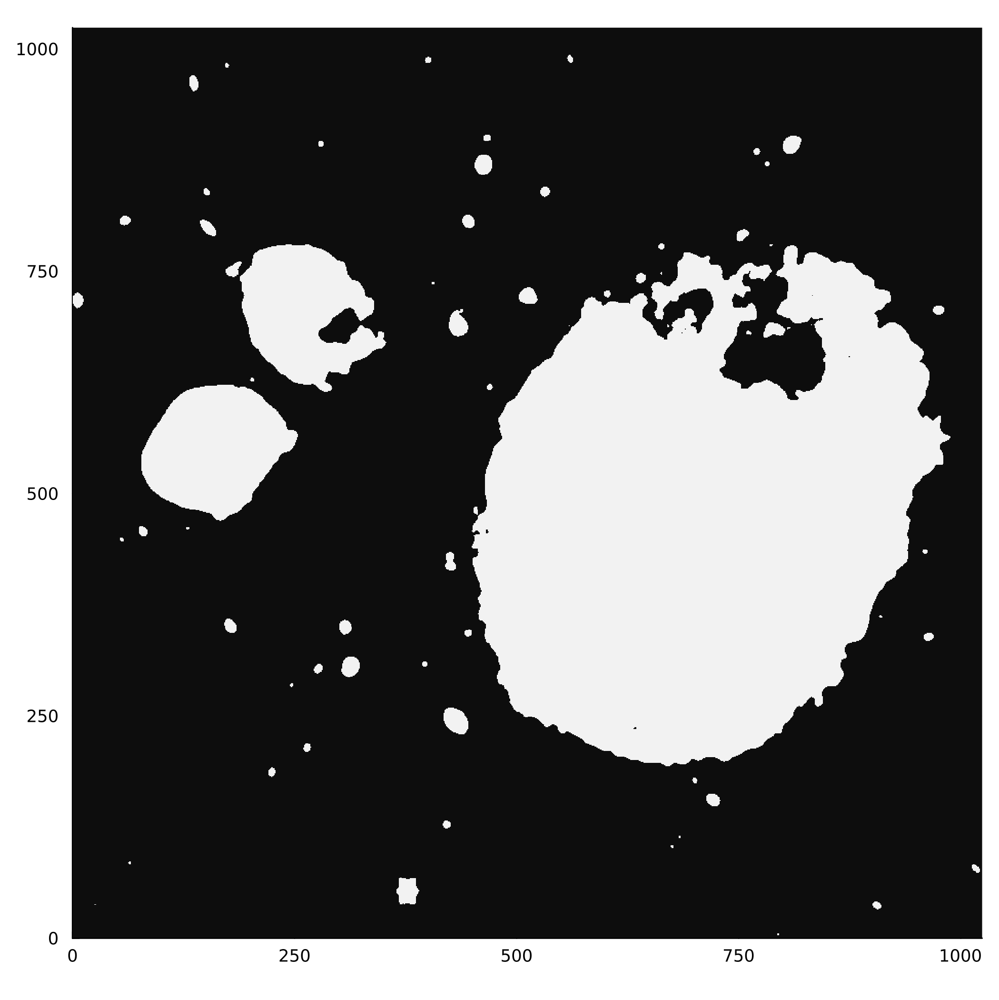

In [10]:
# binarization
x̂_bin = binarize(x̂_final, Otsu(); nbins=4)
x̂_bin = Matrix{Bool}(1 .- x̂_bin)
x̂_bin = imfill(x̂_bin, (1e1, 4e5))
x̂_bin = Matrix{Bool}(1 .- x̂_bin)
plot_dwt(flip(x̂_bin))

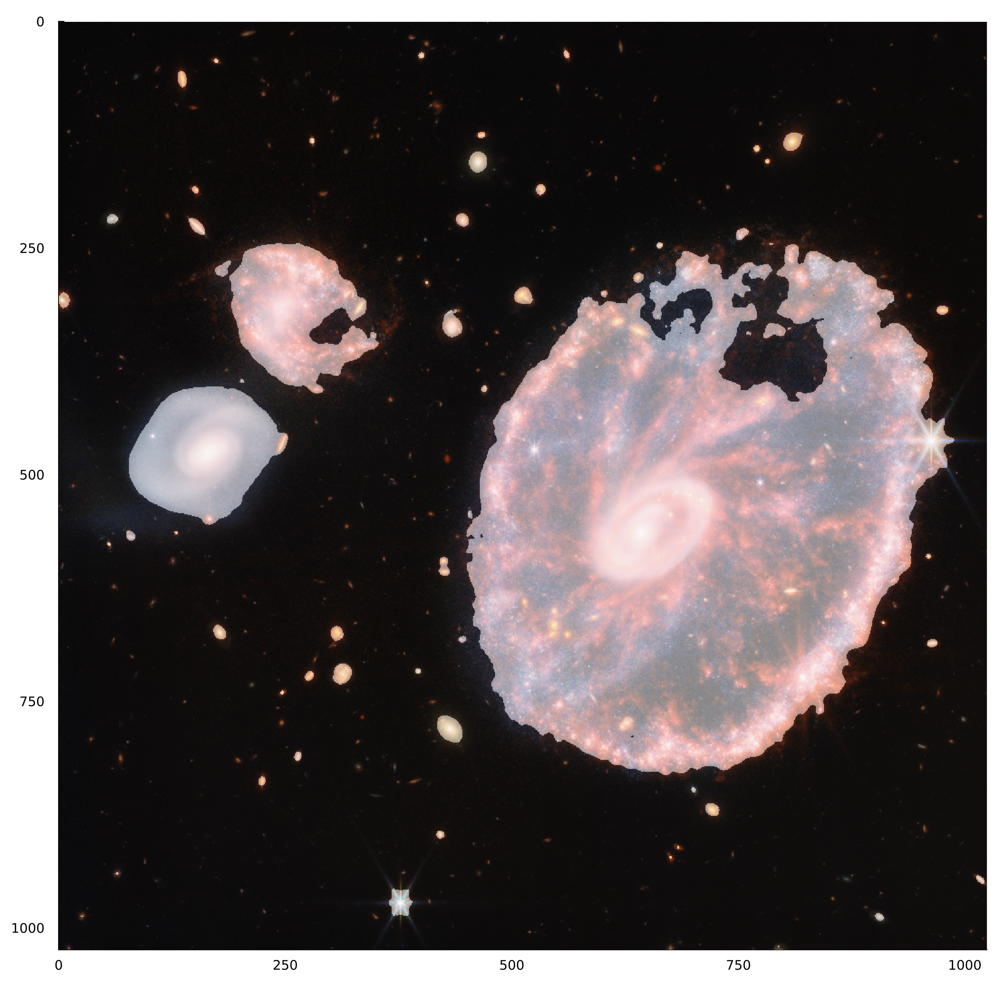

In [11]:
# overlay x̂_bin with the original image
heatmap(img, color=:grays, aspect_ratio=1, cbar=false,
    xlims=(0, size(x, 2)),
    ylims=(0, size(x, 1)),
    size=(900, 900),
    dpi=300
)
heatmap!(x̂_bin, color=:grays, alpha=0.5)

## Clustering

In [16]:
points = Vector{Vector{Int}}()
for i in 1:size(x̂_bin, 1)
    for j in 1:size(x̂_bin, 2)
        if x̂_bin[i, j]
            push!(points, [i, j])
        end
    end
end

points = hcat(points...)
points = convert(Matrix{Float64}, points)
result = dbscan(points, 2.0, min_neighbors=2, min_cluster_size=15)

# Plot the points with the colors of the clusters
N_int = 4
x = Int.(points[2, :])
y = Int.(points[1, :])
groups = result.assignments
N_clusters = maximum(groups)

# create array of tuples(x, y, group)
points = [(x[i], y[i], groups[i]) for i in 1:length(x)];

# remove all points with group=0
points = filter(p -> p[3] != 0, points)

255979-element Vector{Tuple{Int64, Int64, Int64}}:
 (559, 32, 1)
 (560, 32, 1)
 (558, 33, 1)
 (559, 33, 1)
 (560, 33, 1)
 (561, 33, 1)
 (400, 34, 2)
 (401, 34, 2)
 (558, 34, 1)
 (559, 34, 1)
 ⋮
 (910, 990, 51)
 (904, 991, 51)
 (905, 991, 51)
 (906, 991, 51)
 (907, 991, 51)
 (908, 991, 51)
 (909, 991, 51)
 (906, 992, 51)
 (907, 992, 51)

In [ ]:
# Define a palette of colors
colors = distinguishable_colors(N_clusters);

# Plot the points with the colors of the clusters
plt_res = heatmap(img, aspect_ratio=1, cbar=false, legend=false,
    ylims=(0, size(img, 1)),
    xlims=(0, size(img, 2)),
    size=(900, 900),
    dpi=300
)
for (x, y, group) in points
    scatter!(plt_res, [x], [y], color=colors[group], label="Cluster $group", markerstrokewidth=0, markersize=1)
end

# Display the plot
plot!(plt_res,
    xlabel="Width",
    ylabel="Height",
    axis=false,
    legend=false,
)

In [502]:

# clusters =

# function find_clusters(x̂_bin::Matrix{Bool})
#     # find clusters
#     clusters = connected_components(x̂_bin)
#     n_clusters = length(clusters)

#     # plot clusters
#     plt = heatmap(x̂_bin, color=:grays, aspect_ratio=1, cbar=false,
#         xlims=(0, size(x̂_bin, 2)),
#         ylims=(0, size(x̂_bin, 1)),
#         size=(700, 700),
#         dpi=300
#     )

#     for i in 1:n_clusters
#         cluster = clusters[i]
#         for j in 1:length(cluster)
#             x, y = cluster[j]
#             plt = scatter!([y], [x], color=:red, markersize=2)
#         end
#     end

#     return clusters
# end

## Edge detection

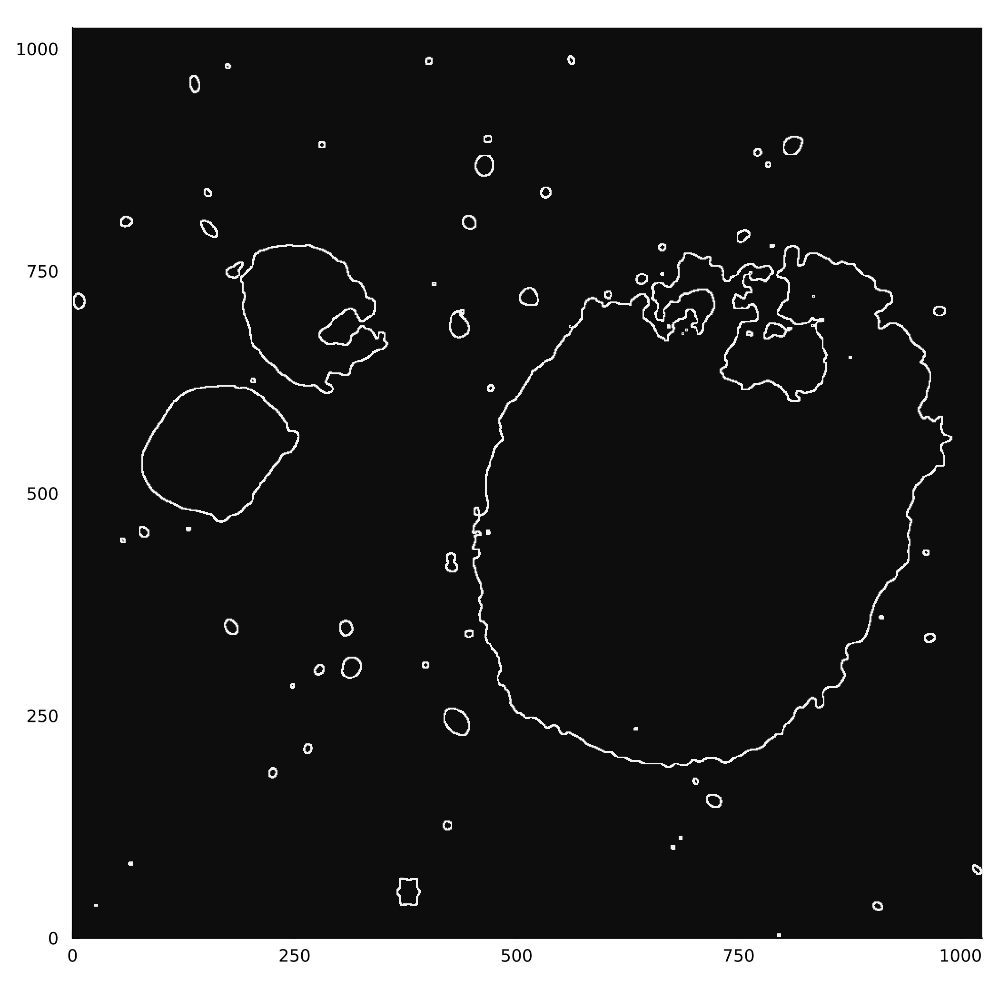

In [503]:
# canny
canny(d1, d2) = canny_edge_detector(Matrix{Float64}(x̂_bin), d1, d2)[1]
edges = canny(1e-3, 1e1)
plot_dwt(flip(edges))

In [23]:
using LinearAlgebra

num = 200*200
u = repeat([1, 0, 0.5], num, 1)
v = repeat([0.9, 0.1, 0.2], num, 1)

# cross product across all columns
w = cross(u, v, dims=2)
# w = [cross(u[:, i], v[:, i]) for i in 1:num]

MethodError: MethodError: no method matching cross(::Matrix{Float64}, ::Matrix{Float64}; dims::Int64)

In [18]:
u

3×40000 Matrix{Float64}:
 1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  …  1.0  1.0  1.0  1.0  1.0  1.0  1.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5     0.5  0.5  0.5  0.5  0.5  0.5  0.5

In [4]:
a = [0; 1; 0]
b = [0; 0; 1]
cross(a, b)

3-element Vector{Int64}:
 1
 0
 0